### **TEXT TO IMAGE STABLE DIFFUSION v1.5**

Firstly, we need to download libraries in order to be able to make our attempts.

In [ ]:
!pip install diffusers
!pip install transformers scipy ftfy accelerate
!pip install compel
!pip install torchsde

This **image_grid** code is for visualization of images.

In [2]:
import PIL
from PIL import Image

# Code for visualization of multiple images
def image_grid(imgs, rows, cols):
    """
    This function takes a list of images and creates a grid of images from them.

    Args:
    imgs (list): List of images to be used in the grid.
    rows (int): Number of rows in the grid.

    Returns:
    grid (Image): The grid of images.
    """

    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

#### **1) Text To Image Stable Diffusion Hyperparameters**

In this section, you will be exploring different hyperparameters of text to image stable diffusion.

**Generator**: If you want to generate almost same image every time, you can use generator with a seed. You can set seed like this **generator = torch.Generator(device="cuda").manual_seed(30)** in the generator. If you remove the generator, you obtain different image for every run.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

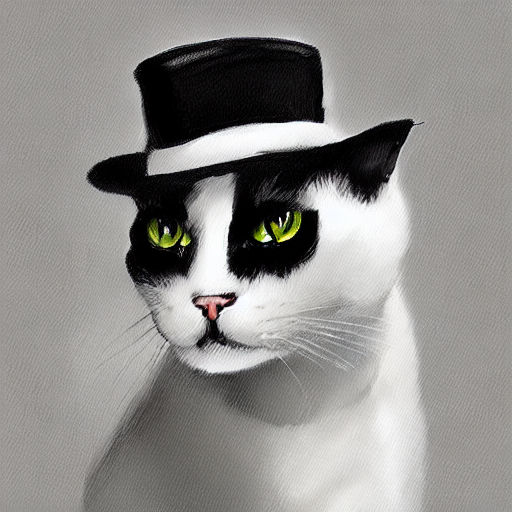

In [4]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel

pipeline = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16").to("cuda")

#pipeline.enable_sequential_cpu_offload()
generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "Black white cat with a hat, digital art"

image = pipeline(prompt=prompt, generator=generator).images[0]

#image.save("result.png")

image

**Negative Prompt:** By using **negative_prompt** hyperparameter, you will be able to remove what you do not want to see in generated image. Additionally, using prompt weight gives some importance to words. You can use Compel library for this. "+" and "-" operators increase and decrease the importance of words, respectively. For example, I don't want any **watermark, text or signature** in my generated image. That's why, I use "+" operator to emphasize this wish.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

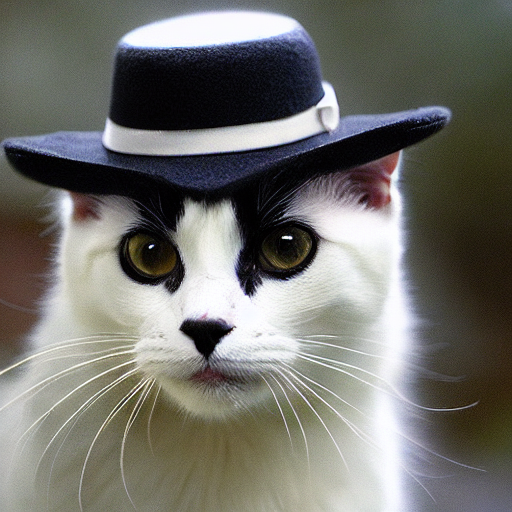

In [5]:
# Code with negative prompt and prompt weight

pipeline = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16").to("cuda")

#pipeline.enable_sequential_cpu_offload()
generator = torch.Generator(device="cuda").manual_seed(30)

compel_proc = Compel(tokenizer=pipeline.tokenizer, text_encoder=pipeline.text_encoder)

prompt = "Black white cat with a hat, digital art"
negative_prompt = "ugly, distorted face, poor details, deformed, big nose, bad art, poorly drawn feet, poorly drawn face, watermark++, text++, signature++, missing arms, missing legs, lying down"

w_prompt = compel_proc(negative_prompt)
image = pipeline(prompt=prompt, negative_prompt_embeds=w_prompt, generator=generator, num_images_per_prompt=5).images[0]

#image.save("result.png")

image

**Guidance Scale:** **guidance_scale** determines the influence of prompt on image generation. If guidance_scale is set to lower values, the model tends to be more creative to generate image. Conversely, the model tends to be stricter to follow the prompt if guidance_scale is set to be higher values. Default value of it is 7.5.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

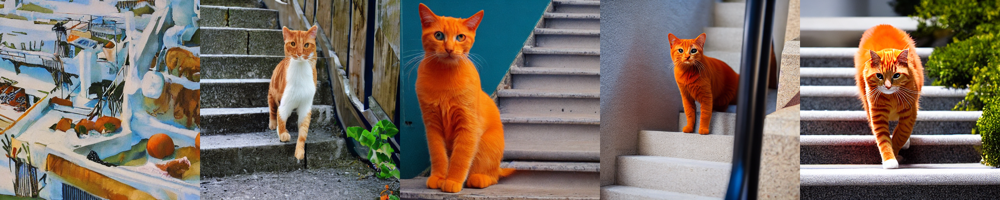

In [6]:
def generate_images_with_different_guidance_scales(prompt, negative_prompt, guidance_scales, seed, device):

    pipeline = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16").to(device)

    generator = torch.Generator(device=device).manual_seed(seed)

    images = []
    for guidance_scale in guidance_scales:
        image = pipeline(prompt=prompt, negative_prompt=negative_prompt, guidance_scale=guidance_scale, generator=generator).images[0]
        images.append(image)

    grid = image_grid(images, 1, len(guidance_scales))

    return grid


# We changed the propmpt.

prompt = "An orange cat blue-eyed, going up the stairs, modern art"
negative_prompt = "ugly, distorted face, poor details, deformed, bad art, poorly drawn feet, poorly drawn face, watermark, text, signature, missing arms, missing legs"

# If you want, you can try different values.
guidance_scales = [0.5, 2.5, 5, 7.5, 10.5]
seed = 30
device = "cuda"

grid = generate_images_with_different_guidance_scales(prompt, negative_prompt, guidance_scales, seed, device)
#grid.save("result.png")

grid

If you want to give multiple prompts, you can give prompts as a list instead of string.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

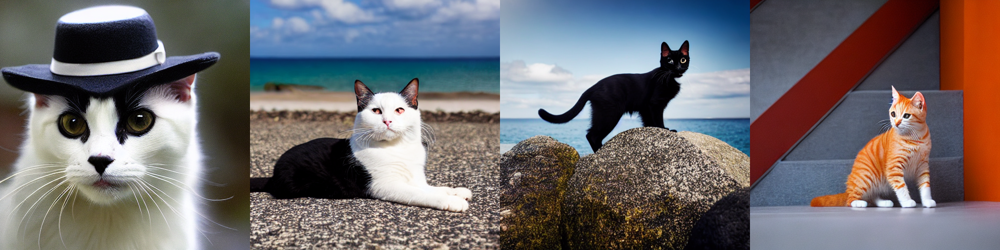

In [7]:
pipeline = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16").to("cuda")

#pipeline.enable_sequential_cpu_offload()
generator = torch.Generator(device="cuda").manual_seed(30)

compel_proc = Compel(tokenizer=pipeline.tokenizer, text_encoder=pipeline.text_encoder)

# List instead of string
prompt = ["Black white cat with a hat, digital art", "A black and white cat++ lying down on a coast with sunny weather, realistic", "A black white cat++ and sea backgorund, realistic", "An orange cat blue-eyed, going up the stairs, modern art"]
negative_prompt = ["ugly, distorted face, poor details, deformed, big nose, bad art, poorly drawn feet, poorly drawn face, watermark++, text++, signature++, missing arms, missing legs, lying down",
                   "ugly, distorted face, poor details, deformed, big nose, bad art, poorly drawn feet, poorly drawn face, watermark++, text++, signature++, missing arms, missing legs",
                   "ugly, distorted face, poor details, deformed, big nose, bad art, poorly drawn feet, poorly drawn face, watermark++, text++, signature++, missing arms, missing legs, bad drawn eyes",
                   "ugly, distorted face, poor details, deformed, big nose, bad art, poorly drawn feet, poorly drawn face, watermark++, text++, signature++, missing arms, missing legs"]

w_prompt = compel_proc(negative_prompt)
images = pipeline(prompt=prompt, negative_prompt_embeds=w_prompt, generator=generator).images

grid = image_grid(images, 1, 4)

#grid.save("result.png")
grid

#### **2) Text To Image Stable Diffusion Models**

You can try lots of different Stable Diffusion v1.5 models in https://huggingface.co/models?other=diffusers%3AStableDiffusionPipeline. Let's take a look some of them. Additionally, I tried a more detailed prompt from now on.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

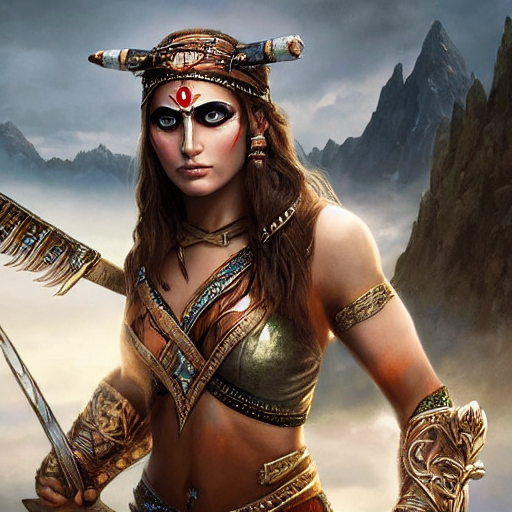

In [8]:
pipeline = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16").to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "fantasy, digital painting portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

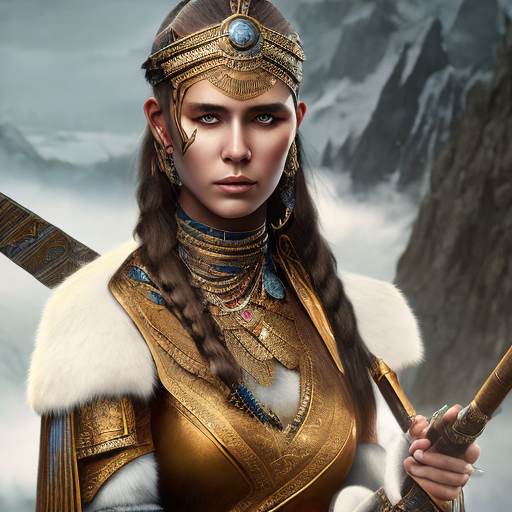

In [17]:
# Stable diffusion model that trained with midjourney images

model_name = "prompthero/openjourney"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "mdjrny-v4 style of portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

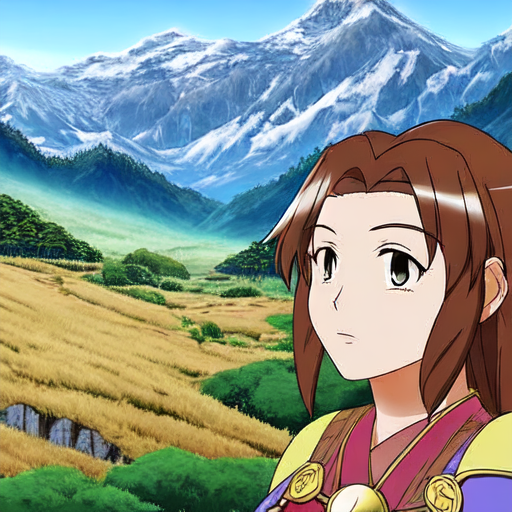

In [18]:
# Stable diffusion model that trained with anime images

model_name = "hakurei/waifu-diffusion"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution, anime"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

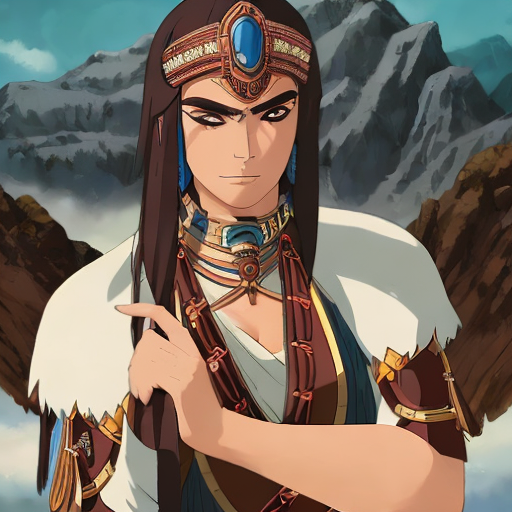

In [19]:
# ghibli style images
# Use the tokens ghibli style in your prompts for the effect.

model_name = "nitrosocke/Ghibli-Diffusion"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution, ghibli style"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

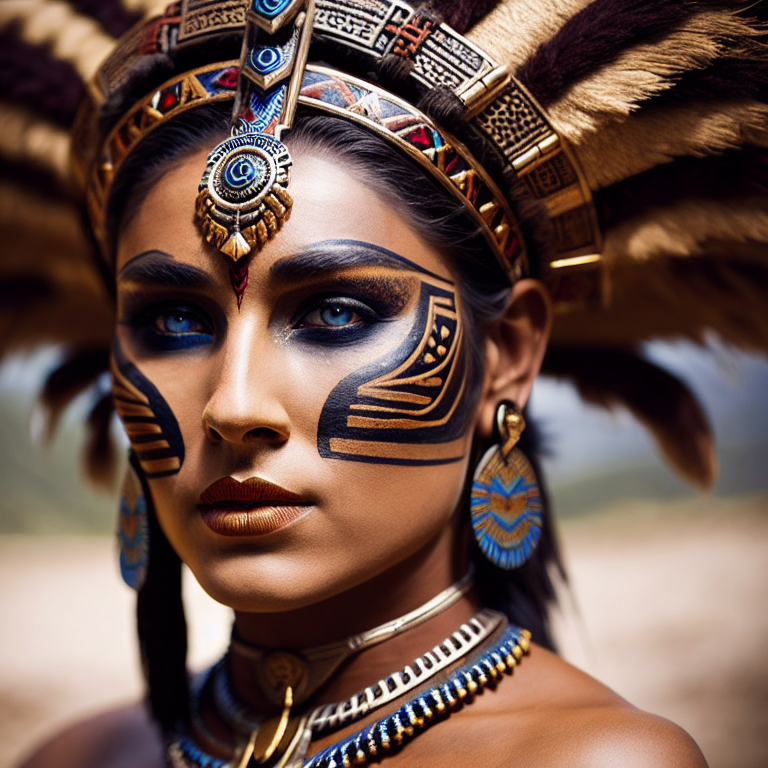

In [20]:
# Photo realistic images

model_name = "dreamlike-art/dreamlike-photoreal-2.0"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

vae/diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

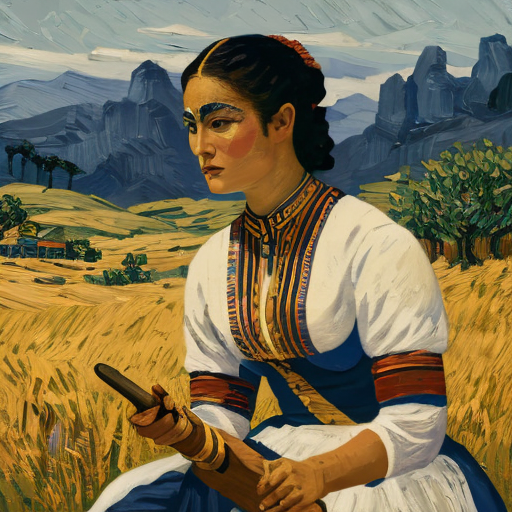

In [21]:
# Van Gogh style images
# We should use "lvngvncnt" at the beginning

model_name = "dallinmackay/Van-Gogh-diffusion"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "lvngvncnt, portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

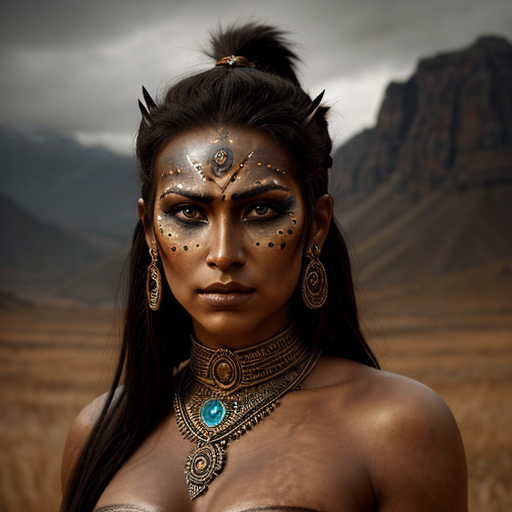

In [22]:
# Epic realism

model_name = "emilianJR/epiCRealism"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

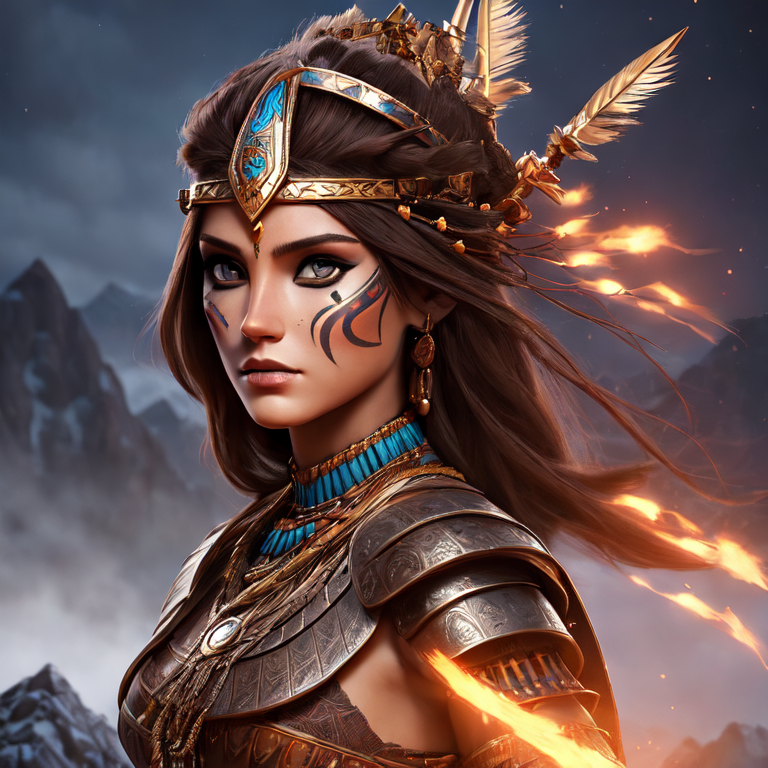

In [23]:
model_name = "Yntec/IsThisArt"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "lvngvncnt, portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

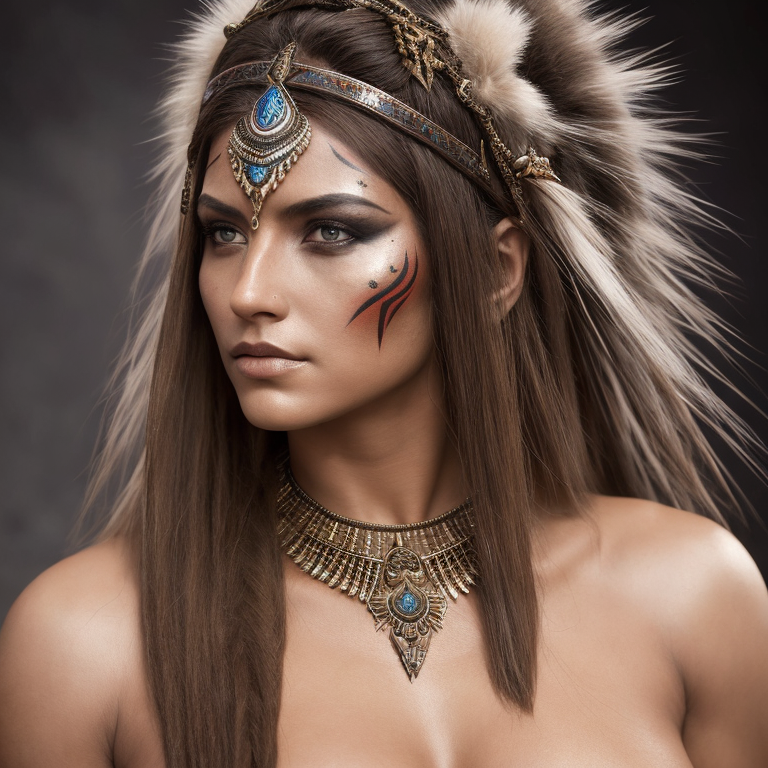

In [24]:
model_name = "Yntec/Analog"
pipeline = StableDiffusionPipeline.from_pretrained(model_name, torch_dtype=torch.float16).to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator).images[0]

#image.save("result.png")

image

#### **3) Text To Image Stable Diffusion Schedulers**

Schedulers are used for denoising process of stable diffusion. Scheduler plays an important role in the denoising process because every step's noise level is different from each other. You can try different scheduler algorithms which exist in the diffuser library. Generally, there is a trade-off between speed and quality. You can take a look to codes with different schedulers.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

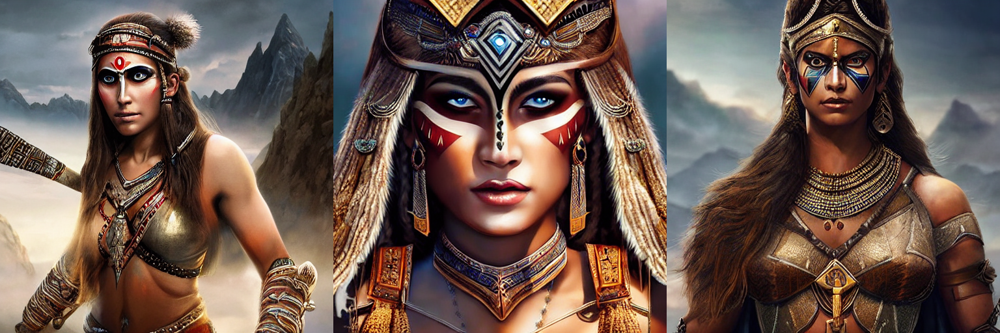

In [25]:
import torch
from diffusers import StableDiffusionPipeline

pipeline = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16").to("cuda")

generator = torch.Generator(device="cuda").manual_seed(30)

prompt = "digital painting portrait of an pretty ancient woman warrior with tribal makeup detailed, dramatic lighting, mountainous backgrounds, high resolution"
negative_prompt = "ugly, distorted face, deformed, bad art, poorly drawn face, amateur, beginner, blurry, signature, watermark"

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

In [26]:
# If you want to access the schedular, parameters you can use this code.
# Default scheduler is PNDMScheduler.
pipeline.scheduler

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.26.2",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "trained_betas": null
}

In [27]:

# You can see the all available schedulers of Stable Diffusion
pipeline.scheduler.compatibles

[diffusers.schedulers.scheduling_dpmsolver_sde.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMSc

  0%|          | 0/50 [00:00<?, ?it/s]

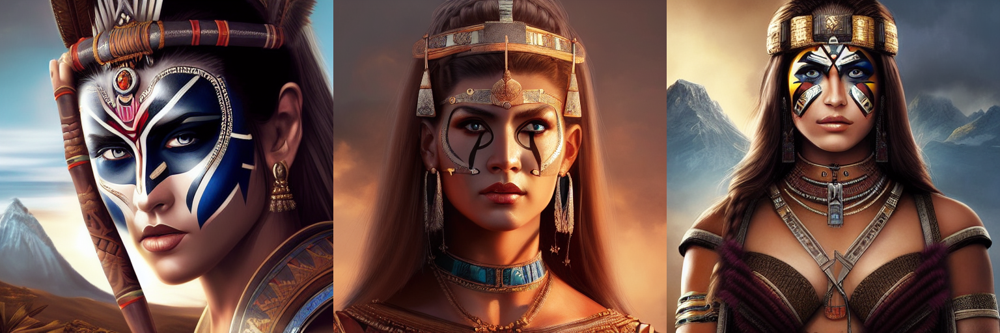

In [28]:
# From now on we're going to try different schedulers and see the variations on images.

from diffusers import DDPMScheduler, KDPM2DiscreteScheduler, DPMSolverMultistepScheduler, HeunDiscreteScheduler, KDPM2AncestralDiscreteScheduler, EulerAncestralDiscreteScheduler, UniPCMultistepScheduler, DPMSolverSDEScheduler, EulerDiscreteScheduler, DPMSolverSinglestepScheduler, DEISMultistepScheduler, DDIMScheduler, LMSDiscreteScheduler

pipeline.scheduler = DDPMScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

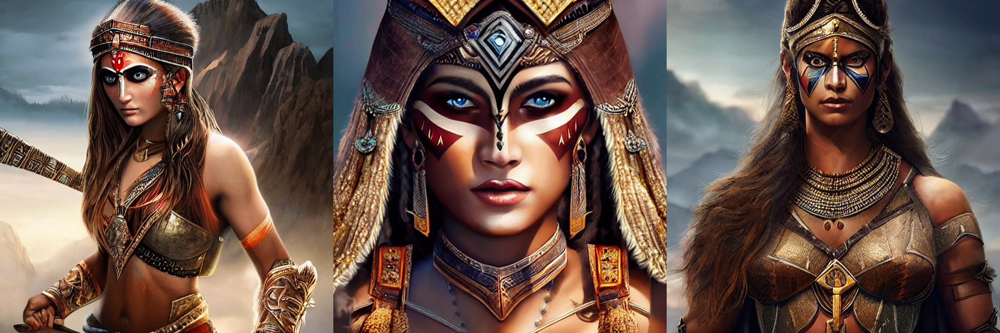

In [29]:
# KDPM2DiscreteScheduler

pipeline.scheduler = KDPM2DiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

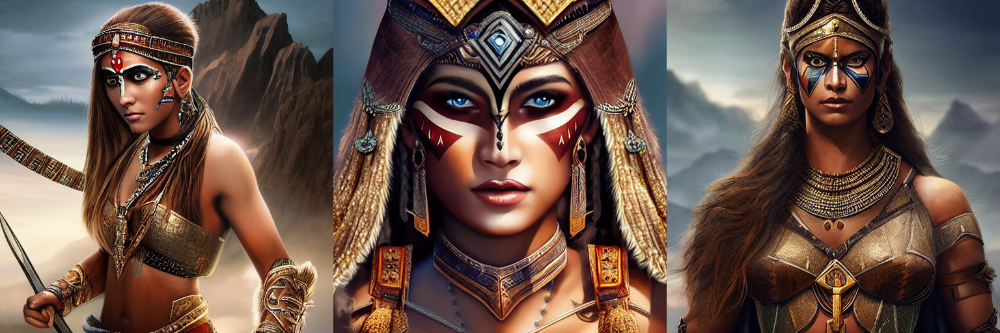

In [30]:
# DPMSolverMultistepScheduler

pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

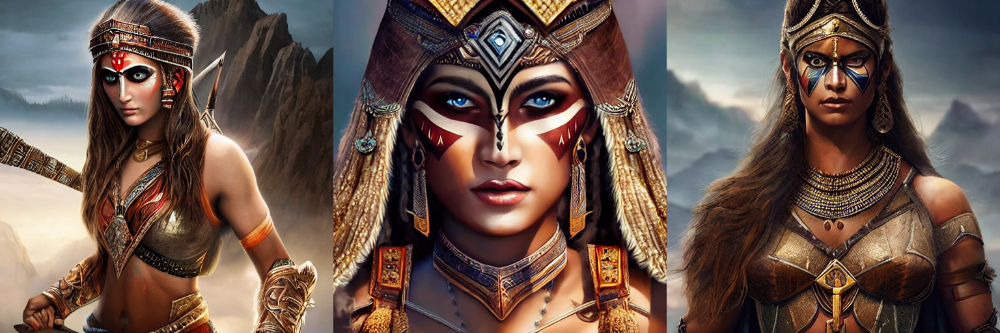

In [31]:
# HeunDiscreteScheduler

pipeline.scheduler = HeunDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

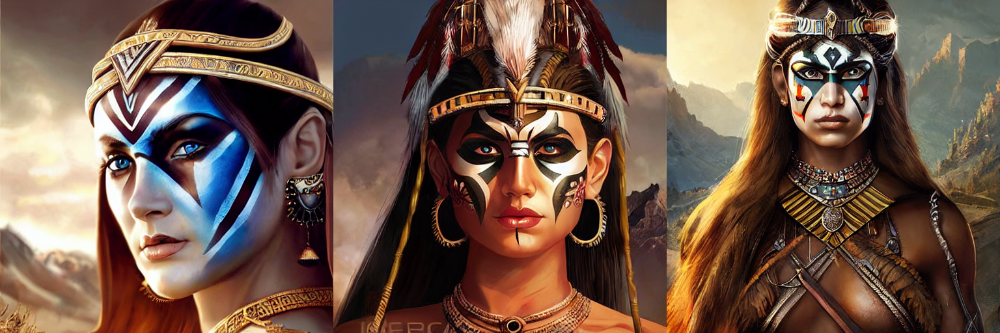

In [32]:
# KDPM2AncestralDiscreteScheduler

pipeline.scheduler = KDPM2AncestralDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

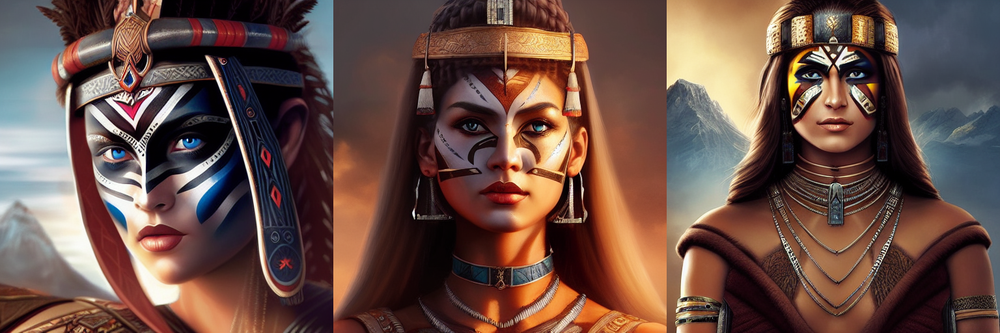

In [33]:
# EulerAncestralDiscreteScheduler

pipeline.scheduler = EulerAncestralDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

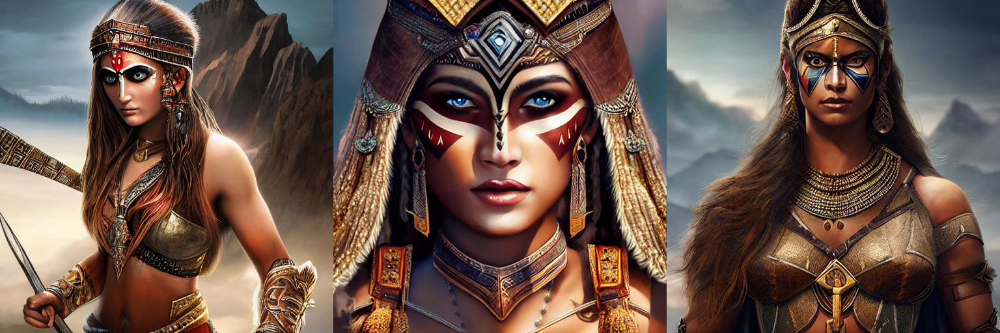

In [34]:
# UniPCMultistepScheduler

pipeline.scheduler = UniPCMultistepScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

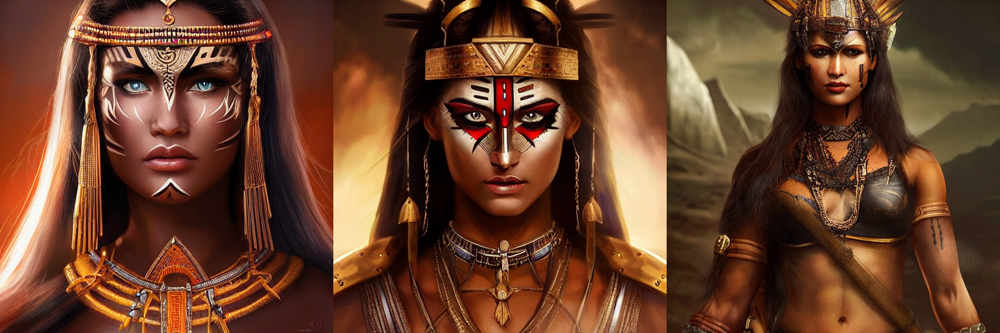

In [40]:
# DPMSolverSDEScheduler

pipeline.scheduler = DPMSolverSDEScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

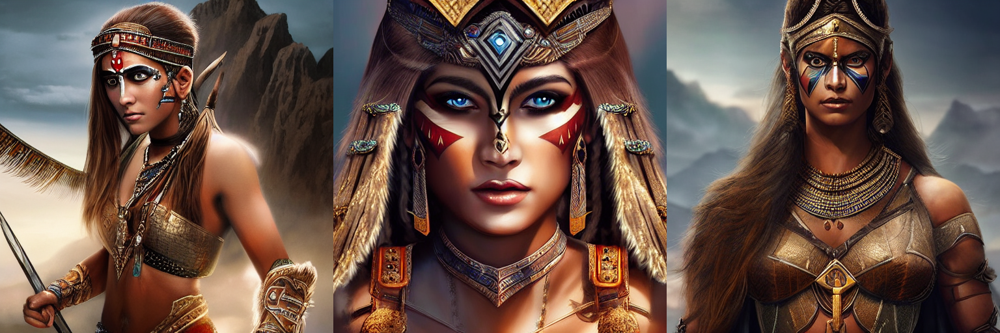

In [36]:
# EulerDiscreteScheduler

pipeline.scheduler = EulerDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

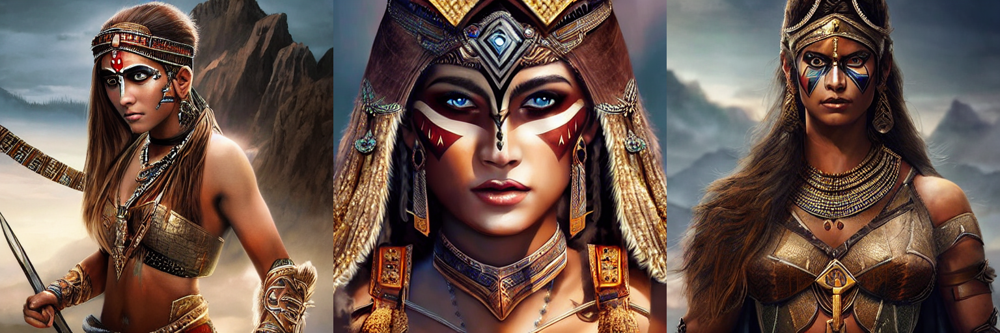

In [37]:
# DEISMultistepScheduler

pipeline.scheduler = DEISMultistepScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

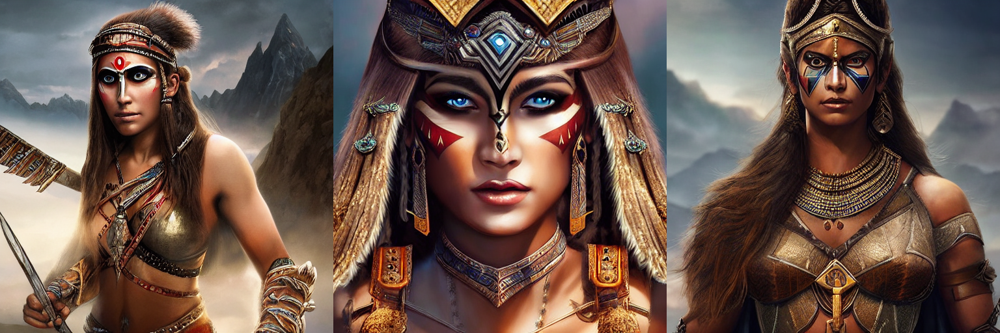

In [38]:
# DDIMScheduler

pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

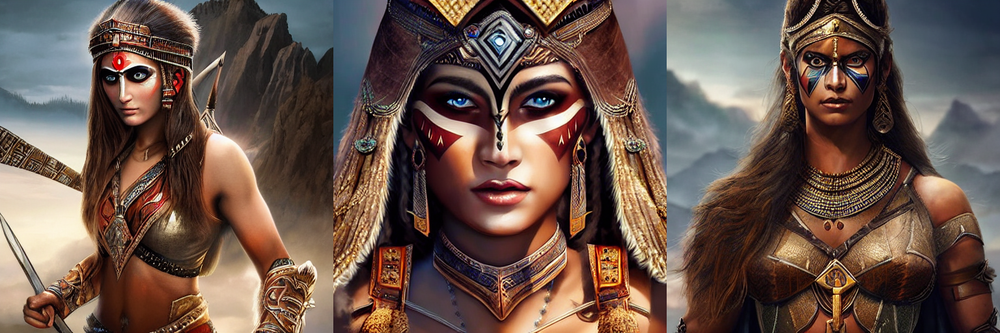

In [39]:
# LMSDiscreteScheduler

pipeline.scheduler = LMSDiscreteScheduler.from_config(pipeline.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(30)

image = pipeline(prompt=prompt, negative_prompt=negative_prompt, generator=generator, num_images_per_prompt=3).images

grid = image_grid(image, 1, 3)
grid